In [1]:
%pylab inline
import cv2
import numpy as np
import logging
import math
import csv

Populating the interactive namespace from numpy and matplotlib


### Display Methods

In [2]:
def display_frame(cap, index):
    ''' Display a frame from a video capture stream. '''
    frame = get_frame(cap, index)
    display_image(frame)

In [3]:
def display_image(image):
    ''' Show an image in a matplotlib figure. '''
    # If colored, swap color order to RGB
    if len(image.shape) > 2:
        image = image[:,:,[2,1,0]]
        imshow(image)
    else:
        imshow(image, cmap=cm.Greys)

In [4]:
def image_rows(images, ncols=4):
    matrix = []
    for i in xrange(0, len(images), ncols):
        matrix.append(images[i:i+ncols])
    image_matrix(matrix)

In [5]:
def image_matrix(images, imgsize=(8, 5), save=False):
    ''' Show matrix of images of variable size. '''
    if len(images) == 0 or len(images[0]) == 0:
        return
    rows = len(images)
    cols = len(images[0])
    w, h = imgsize
    figure(figsize=(w * cols, h * rows))
    for r, row in enumerate(images):
        for c, img in enumerate(row):
            spn = r * cols + c + 1
            subplot(rows, cols, spn)
            display_image(img)
    if save:
        savefig('results.png')

In [6]:
def draw_rectangle(image, rect):
    ''' Draw a rectangle on an image. '''
    l, t, w, h = rect
    cv2.rectangle(image, 
        (l, t),
        (l + w, t + h), 
        (0, 255, 0), 10)

### Video Stream Methods

In [7]:
''' Helpers for fetching specific frames. '''
get_findex = lambda cap : int(cap.get(cv2.cv.CV_CAP_PROP_POS_FRAMES))
set_findex = lambda cap, f : cap.set(cv2.cv.CV_CAP_PROP_POS_FRAMES, f)

In [8]:
def get_frame(cap, index):
    ''' Modified from code on SO question, "How to process images of a video, frame 
        by frame in video streaming using Opencv python "'''
    
    set_findex(cap, index)    
    logging.debug("Fetching frame %d", index)

    while True:
        flag, frame = cap.read()    
        if flag:
            logging.debug("Got frame %d", index)
            return frame
            break
        else:
            logging.debug("Frame %d not ready, trying again", index)
            # The frame number increments after a read attempt.
            # Furthermore, to try to read frame i, we set frame number to i + 1.
            # I don't know why, but this is just how the API works.
            index = get_findex(cap)
            set_findex(cap, index)
            cv2.waitKey(500)

# Main Tests

###Preparation

Load video streams

In [9]:
video_paths = [
    'videos/1-vXcC533_IcQ-Android_-_Eclipse_-_02_-_Creating_a_Custom_Splash_Screen_-_Tutorial.mp4',
    'videos/2--MBS2YvUY2M-Android_Facebook_Login_integration_with_Eclipse..mp4',
    'videos/3-p9KRJoX13vo-Android_Development_Tutorial_-_How_To_Make_an_App_and_Run_It_In_The_Emulator.mp4',
    'videos/4-o1vRJ07KDZ0-Android_tutorial_make_android_calculator_app_video_how_to_create_a_calculator_in_android_shashank_ku.mp4',
    'videos/5-ok8mZW_BDG4-Eclipse_Java_Hello_World_Introduction_Tutorial.mp4'
]
streams = [cv2.VideoCapture(p) for p in video_paths]

Open up test data

In [10]:
# Frame rate corrections for where QuickTime's perceived FPS
# is different than what OpenCV reads in
# Also, we found extracted rectangle positions from smaller images than the
# actual video feed, so we have to scale them back up
fcorr = {
    1: 29.41176470588235 / 29.970030,
    3: 14.925373134328359 / 15,
    5: 29.41176470588235 / 30,
}
scorr = {
    1: (852.0/639, 480.0/360),
    2: (854.0/641, 460.0/345),
    3: (854.0/588, 480.0/330),
    4: (854.0/608, 464.0/330),
    5: (768.0/576, 480.0/360),
}

In [11]:
with open('rectangles.csv') as datafile:
    data = csv.DictReader(datafile, )
    records = []
    for r in data:
        records.append(r)

In [12]:
events = []

for r in records:

    # Get video and frame index
    vindex = int(r['Vindex'])
    frame_index = int(int(r['Frame']) * fcorr.get(vindex, 1))

    # Load up rectangle data
    xcorr, ycorr = scorr.get(vindex, 1)    
    x, w = [int(int(d) * xcorr) for d in (r['x'], r['w'])]
    y, h = [int(int(d) * ycorr) for d in (r['y'], r['h'])]
    
    # Store as more readable event dictionary
    event = {
        'stream_index': vindex - 1,
        'frame_index': frame_index,
        'rect': (x, y, w, h),
    }
    events.append(event)

Show the frames and menu regions from the test data

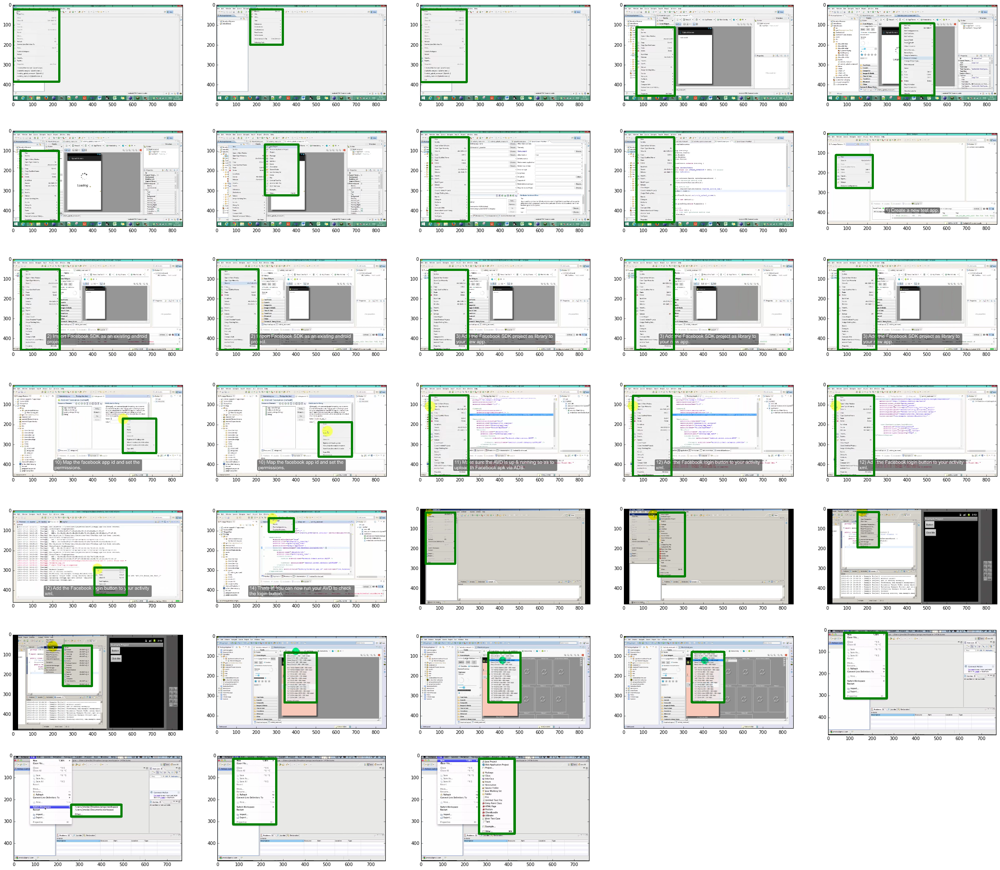

In [13]:
frames = []
frames_with_rects = []
for e in events: 
    f = get_frame(streams[e['stream_index']], e['frame_index'])
    x,y,w,h = e['rect']
    f_rect = f.copy()
    cv2.rectangle(f_rect, (x,y), (x+w,y+h), (0,128,0), 10)
    frames.append(f)
    frames_with_rects.append(f_rect)  

image_rows(frames_with_rects, ncols=5)

### Running Edge Detection on Video Frames

#### Image Processing Methods

In [14]:
def blur_image(image, ksize=(15,15), sigma=7):
    return cv2.GaussianBlur(image, ksize, sigma)

In [15]:
def binarize(image, threshold=30):
    _, binarized = cv2.threshold(image.copy(), threshold, 255, cv2.THRESH_BINARY)
    scaled = binarized
    return scaled

In [16]:
def get_contours(image, minarea=5000):
    contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours = filter(lambda c: cv2.contourArea(c) > 5000, contours)
    return contours

In [17]:
to_rgb = lambda img: cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
to_grey = lambda img: cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

#### Determining the ideal Canny thresholds

In [18]:
def cannyRange(image, tmin=0, tmax=400, step=50, ratio=2):
    ''' Perform Canny edge detection at a range of thresholds, returning images found for each threshold pair. '''
    edge_candidates = []
    for low_thresh in xrange(tmin, tmax, step):
        high_thresh = low_thresh * ratio
        edges = cv2.Canny(image, low_thresh, high_thresh)
        edge_candidates.append(edges)
    return edge_candidates

In [20]:
matrix = []
for f in frames:
    edge_candidates = cannyRange(f, tmin=0, tmax=600, step=100, ratio=2)
    matrix.append([f] + edge_candidates)

ERROR! Session/line number was not unique in database. History logging moved to new session 854


In [23]:
image_matrix(matrix, imgsize=(15,10))